# JPEG ERROR ANALYSIS AND ITS APPLICATIONS TO DIGITAL IMAGE FORENSICS

## Step 1: Y Encoding and Decoding (All functions required)

In [1]:
import cv2
import numpy as np

import cv2
import numpy as np
import pandas as pd
from matplotlib import cm
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
from matplotlib.colors import Normalize


# write arr to excel
def write_xlsx(arr, path):
    return pd.DataFrame(arr).to_excel(path)

# load img as arr using opencv
def load_img(img):
    return cv2.imread(img)

# convert rgb to yuv
def rgb2yuv(img):
    return cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)

# convert bgr to rgb
def bgr2rgb(img):
    return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Split channel: splits image into color channels
def split_channel(img):
    return cv2.split(img)

# get scale alpha: returns quantization matrix for given JPEG quality factor
def get_Q(q_jpeg):
    QTable = np.array([[16,11,10,16, 24,40, 51, 61],
                   [12,12,14,19, 26,48, 60, 55],
                   [14,13,16,24, 40,57, 69, 56],
                   [14,17,22,29, 51,87, 80, 62],
                   [18,22,37,56, 68,109,103,77],
                   [24,35,55,64, 81,104,113,92],
                   [49,64,78,87,103,121,120,101],
                   [72,92,95,98,112,100,103,99]])
    
    if q_jpeg < 50 and q_jpeg > 1:
        alpha = np.floor(5000.0/q_jpeg)
        Q = QTable*alpha
    elif q_jpeg < 100:
        alpha = np.floor(200 - 2*q_jpeg)
        Q = QTable*alpha
    elif q_jpeg == 100:
        Q = np.ones((8, 8))
    else:
        raise AttributeError("Quality Factor must be in the range [1..100]")
    return Q

# gets the Mean Squared Error for 2 images
def get_mse(prediction, target):
    return np.sqrt(((prediction-target)**2).mean())

# returns the Peak Signal-to-Noise Ratio (PSNR) in decibels (dB) for a given MSE
def get_psnr(mse):
    return 20*np.log10(255/np.sqrt(mse))

def demo(qf, source):
    QF = qf

    # Init block 8x8
    block = 8
    h, w = np.array(source.shape[:2])/block*block
    h, w = int(h), int(w)
    source = source[:h, :w]

    blocksV = int(h/block)
    blocksH = int(w/block)
    vis0 = np.zeros((h, w), np.float32)
    result = np.zeros((h, w), np.float32)
    vis0[:h, :w] = source

    Q = get_Q(QF)
    print('q_JPEG: ', QF)
    print('\nmatrix Q_Y*alpha:\n', Q)

    # Perform DCT 8x8
    for row in range(blocksV):
        for col in range(blocksH):
            current_block = vis0[row*block:(row+1)*block, col*block:(col+1)*block]
            dct = cv2.dct(current_block)
            if row==0 and col==0:
                print('\nfirst block 8x8 of DCT(source) lossless:\n', np.round(dct).astype(int))
            result_ = np.round(dct/Q).astype(int)
            result[row*block:(row+1)*block, col*block:(col+1)*block] = result_

    # Write source, and result DCT as result_DCT.jpg
    cv2.imwrite("./output/result_DCT_{}.jpg".format(QF), np.hstack([y, result]))
    # Write array of result DCT to excel
    write_xlsx(result, "./output/result_DCT_{}.xlsx".format(QF))

    # Convert back use IDCT
    back = np.zeros((h, w), np.float32)
    for row in range(blocksV):
        for col in range(blocksH):
            current_block = result[row*block:(row+1)*block, col*block:(col+1)*block]
            idct = cv2.idct(current_block*Q)
            back[row*block:(row+1)*block, col*block:(col+1)*block] = np.round(idct).astype(int)
            if row==0 and col==0:
                print('\nfirst block 8x8 of IDCT(source) lossy:\n', np.round(idct).astype(int))

    cv2.imwrite("./output/result_IDCT_{}.jpg".format(QF), np.hstack([y, result, back]))
    mse = get_mse(back, y)
    psnr = np.round(get_psnr(mse), 2)
    print('\nPSNR (QF={}) : {} dB'.format(QF, psnr))
    print('\nOpen file : ./output/result_IDCT_{}.jpg\n'.format(QF))

## Step 2: Load the Source Image

In [2]:
# Load source.jpg
source = load_img("./input/source.jpg")
# convert source.jpg to YUV Channel
yuv = rgb2yuv(source)
# split YUV channel
y, u, v = split_channel(yuv)
# Write array of Y to excel
write_xlsx(y, "./output/Y_Channel.xlsx")

## Step 3: Perform the DCT with Y Channel as Source

In [3]:
# Perform DCT with Y Channel as source
np.set_printoptions(precision=4, suppress=True)
source = y

QFs = [100.0, 99.0, 98.0, 96.0, 94.0, 92.0]

for qf in QFs:
    #print('For QF : ', qf)
    demo(qf, source)
    print('=====================================\n\n\n\n\n')

q_JPEG:  100.0

matrix Q_Y*alpha:
 [[1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]]

first block 8x8 of DCT(source) lossless:
 [[680   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0]]

first block 8x8 of IDCT(source) lossy:
 [[85 85 85 85 85 85 85 85]
 [85 85 85 85 85 85 85 85]
 [85 85 85 85 85 85 85 85]
 [85 85 85 85 85 85 85 85]
 [85 85 85 85 85 85 85 85]
 [85 85 85 85 85 85 85 85]
 [85 85 85 85 85 85 85 85]
 [85 85 85 85 85 85 85 85]]

PSNR (QF=100.0) : 57.92 dB

Open file : ./output/result_IDCT_100.0.jpg






q_JPEG:  99.0

matrix Q_Y*alpha:
 [[ 32.  22.  20.  32.  48.  80. 102. 122.]
 [ 24.  24.

## Step 4: Error Analysis

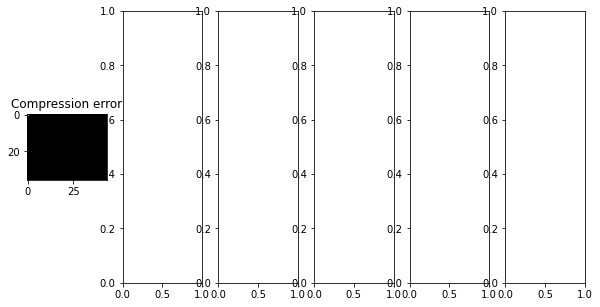

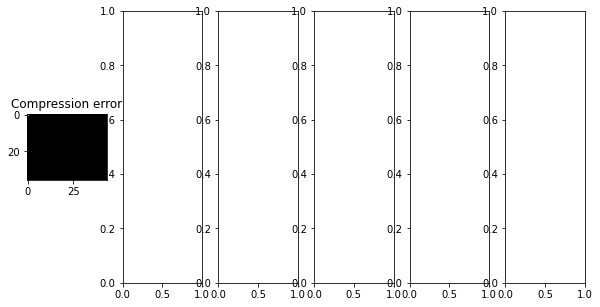

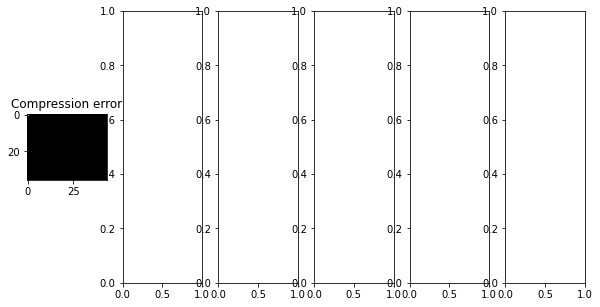

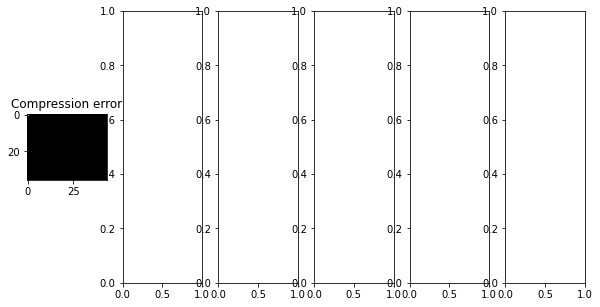

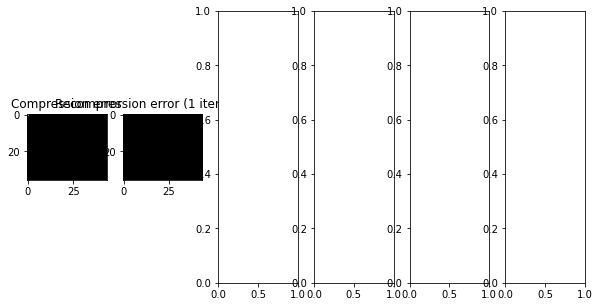

...

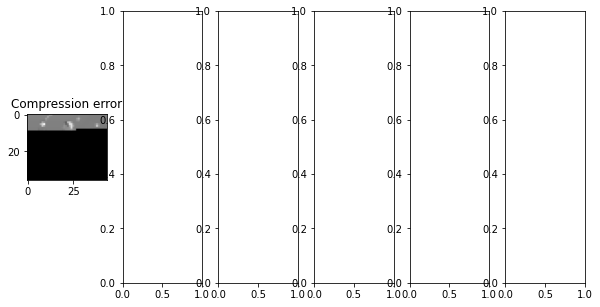

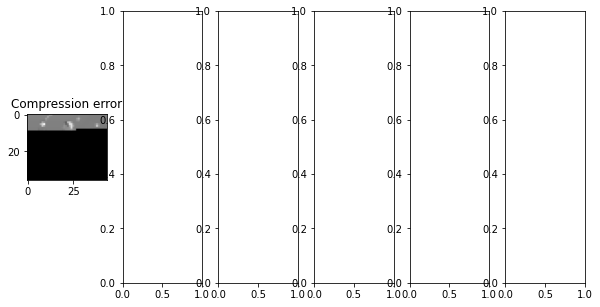

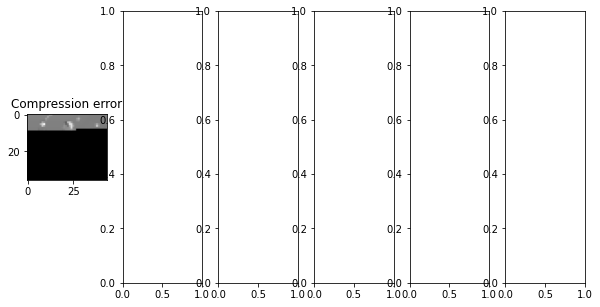

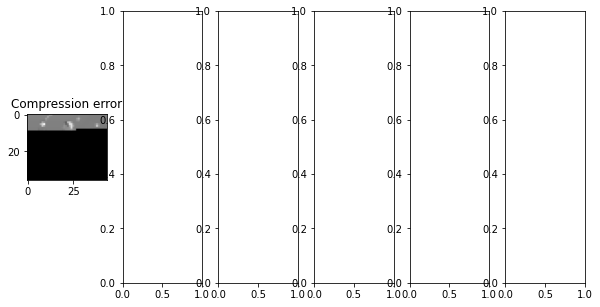

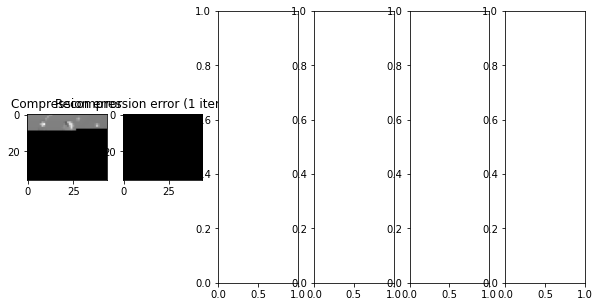

KeyboardInterrupt: 

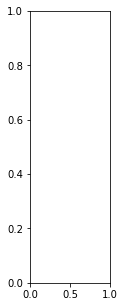

In [10]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fftpack import dct, idct
from skimage import io

# Load the original image, reads an image file and returns a numpy array.
img = io.imread('./input/source.jpg')

# Convert the image to grayscale
img_gray = io.imread('./input/source.jpg', as_gray=True)

# Set the block size for the DCT transform
block_size = 8

# Calculate the dimensions of the image and the number of blocks in each dimension
height, width = img_gray.shape
num_blocks_vert = height // block_size
num_blocks_horiz = width // block_size

# Set the quality factor for the JPEG compression
quality_factor = 50

# Set the number of times to recompress the image
num_recompressions = 5

# Initialize arrays to store the compression and recompression errors
compression_errors = np.zeros((num_blocks_vert, num_blocks_horiz))
recompression_errors = np.zeros((num_blocks_vert, num_blocks_horiz, num_recompressions))

# Loop through each block of the image
for i in range(num_blocks_vert):
    for j in range(num_blocks_horiz):
        # Extract the current block
        block = img_gray[i*block_size:(i+1)*block_size, j*block_size:(j+1)*block_size]

        # Apply the DCT transform to the block
        dct_block = dct(block, norm='ortho')

        # Calculate the quantization matrix based on the quality factor
        quantization_matrix = np.round((1 + (quality_factor / 50)) * np.array([
            [16, 11, 10, 16, 24, 40, 51, 61],
            [12, 12, 14, 19, 26, 58, 60, 55],
            [14, 13, 16, 24, 40, 57, 69, 56],
            [14, 17, 22, 29, 51, 87, 80, 62],
            [18, 22, 37, 56, 68, 109, 103, 77],
            [24, 35, 55, 64, 81, 104, 113, 92],
            [49, 64, 78, 87, 103, 121, 120, 101],
            [72, 92, 95, 98, 112, 100, 103, 99]
        ]))

        # Apply quantization to the DCT coefficients
        quantized_dct_block = np.round(dct_block / quantization_matrix)

        # Calculate the compression error
        compressed_block = idct(quantized_dct_block * quantization_matrix, norm='ortho')
        compression_errors[i, j] = np.mean(np.abs(block - compressed_block))

        # Recompress the block multiple times
        for k in range(num_recompressions):
            # Apply the DCT transform to the quantized block
            dct_quantized_block = dct(quantized_dct_block, norm='ortho')

            # Apply the quantization matrix to the DCT coefficients
            quantized_dct_quantized_block = np.round(dct_quantized_block / quantization_matrix)

            # Apply quantization to the DCT coefficients
            quantized_recompressed_block = idct(quantized_dct_quantized_block * quantization_matrix, norm='ortho')

            # Calculate the recompressed block
            recompressed_block = idct(quantized_recompressed_block, norm='ortho')
            recompression_errors
            #Visualize the compression and recompression errors
            fig, ax = plt.subplots(nrows=1, ncols=num_recompressions+1, figsize=(10,5))
            ax[0].imshow(compression_errors, cmap='gray')
            ax[0].set_title('Compression error')
        for k in range(num_recompressions):
            ax[k+1].imshow(recompression_errors[:,:,k], cmap='gray')
            ax[k+1].set_title(f'Recompression error ({k+1} iteration(s))')
            plt.show()

### Result in the files path: result_IDCT_96.0.jpg

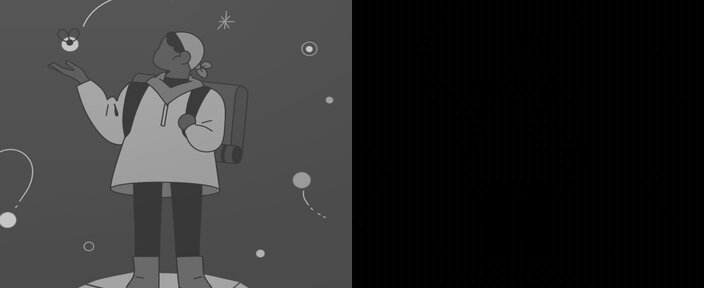

## New Step 1: Y Encoding and Decoding (UPDATED)

In [17]:
import cv2
import numpy as np
import pandas as pd
from matplotlib import cm
import matplotlib.pyplot as plt
import matplotlib.pylab as pylab
from matplotlib.colors import Normalize
from skimage.metrics import structural_similarity as ssim


# write arr to excel
def write_xlsx(arr, path):
    return pd.DataFrame(arr).to_excel(path)

# load img as arr using opencv
def load_img(img):
    return cv2.imread(img)

# convert rgb to yuv
def rgb2yuv(img):
    return cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)

# convert bgr to rgb
def bgr2rgb(img):
    return cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Split channel: splits image into color channels
def split_channel(img):
    return cv2.split(img)

# get scale alpha: returns quantization matrix for given JPEG quality factor
def get_Q(q_jpeg):
    QTable = np.array([[16,11,10,16, 24,40, 51, 61],
                   [12,12,14,19, 26,48, 60, 55],
                   [14,13,16,24, 40,57, 69, 56],
                   [14,17,22,29, 51,87, 80, 62],
                   [18,22,37,56, 68,109,103,77],
                   [24,35,55,64, 81,104,113,92],
                   [49,64,78,87,103,121,120,101],
                   [72,92,95,98,112,100,103,99]])
    
    if q_jpeg < 50 and q_jpeg > 1:
        alpha = np.floor(5000.0/q_jpeg)
        Q = QTable*alpha
    elif q_jpeg < 100:
        alpha = np.floor(200 - 2*q_jpeg)
        Q = QTable*alpha
    elif q_jpeg == 100:
        Q = np.ones((8, 8))
    else:
        raise AttributeError("Quality Factor must be in the range [1..100]")
    return Q

# gets the Mean Squared Error for 2 images
def get_mse(prediction, target):
    return np.sqrt(((prediction-target)**2).mean())

# returns the Structural Similarity Index (SSIM) for two images
def get_ssim(prediction, target):
    gray1 = prediction
    gray2 = target
    # Constants for SSIM calculation
    K1 = 0.01
    K2 = 0.03
    L = 255

    # Compute the mean, variance, and covariance of the two images
    mu1 = cv2.mean(gray1)[0]
    mu2 = cv2.mean(gray2)[0]
    sigma1 = cv2.meanStdDev(gray1)[1][0][0]
    sigma2 = cv2.meanStdDev(gray2)[1][0][0]
    sigma12 = np.cov(gray1.flatten(), gray2.flatten())[0][1]

    # Constants for SSIM calculation
    C1 = (K1 * L) ** 2
    C2 = (K2 * L) ** 2

    # Compute SSIM
    numerator = (2 * mu1 * mu2 + C1) * (2 * sigma12 + C2)
    denominator = (mu1 ** 2 + mu2 ** 2 + C1) * (sigma1 ** 2 + sigma2 ** 2 + C2)
    ssim_score = numerator / denominator
    return ssim_score


def demo(qf, source):
    QF = qf

    # Init block 8x8
    block = 8
    h, w = np.array(source.shape[:2])/block*block
    h, w = int(h), int(w)
    source = source[:h, :w]

    blocksV = int(h/block)
    blocksH = int(w/block)
    vis0 = np.zeros((h, w), np.float32)
    result = np.zeros((h, w), np.float32)
    vis0[:h, :w] = source

    Q = get_Q(QF)
    print('q_JPEG: ', QF)
    print('\nmatrix Q_Y*alpha:\n', Q)

    # Perform DCT 8x8
    for row in range(blocksV):
        for col in range(blocksH):
            current_block = vis0[row*block:(row+1)*block, col*block:(col+1)*block]
            dct = cv2.dct(current_block)
            if row==0 and col==0:
                print('\nfirst block 8x8 of DCT(source) lossless:\n', np.round(dct).astype(int))
            result_ = np.round(dct/Q).astype(int)
            result[row*block:(row+1)*block, col*block:(col+1)*block] = result_

    # Write source, and result DCT as result_DCT.jpg
    cv2.imwrite("./output/result_DCT_{}.jpg".format(QF), np.hstack([y, result]))
    # Write array of result DCT to excel
    write_xlsx(result, "./output/result_DCT_{}.xlsx".format(QF))

    # Convert back use IDCT
    back = np.zeros((h, w), np.float32)
    for row in range(blocksV):
        for col in range(blocksH):
            current_block = result[row*block:(row+1)*block, col*block:(col+1)*block]
            idct = cv2.idct(current_block*Q)
            back[row*block:(row+1)*block, col*block:(col+1)*block] = np.round(idct).astype(int)
            if row==0 and col==0:
                print('\nfirst block 8x8 of IDCT(source) lossy:\n', np.round(idct).astype(int))

    cv2.imwrite("./output/result_IDCT_{}.jpg".format(QF), np.hstack([y, result, back]))
    mse = get_mse(back, y)
    ssim = get_ssim(back, y)
    print('\nSSIM (QF={}) : {} dB'.format(QF, ssim))
    print('\nOpen file : ./output/result_IDCT_{}.jpg\n'.format(QF))

## Load Images

In [18]:
# Load source.jpg
source = load_img("./input/source.jpg")
# convert source.jpg to YUV Channel
yuv = rgb2yuv(source)
# split YUV channel
y, u, v = split_channel(yuv)
# Write array of Y to excel
write_xlsx(y, "./output/Y_Channel.xlsx")

In [19]:
# Perform DCT with Y Channel as source
np.set_printoptions(precision=4, suppress=True)
source = y

QFs = [100.0, 99.0, 98.0, 96.0, 94.0, 92.0]

for qf in QFs:
    #print('For QF : ', qf)
    demo(qf, source)
    print('=====================================\n\n\n\n\n')

q_JPEG:  100.0

matrix Q_Y*alpha:
 [[1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]
 [1. 1. 1. 1. 1. 1. 1. 1.]]

first block 8x8 of DCT(source) lossless:
 [[680   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0]]

first block 8x8 of IDCT(source) lossy:
 [[85 85 85 85 85 85 85 85]
 [85 85 85 85 85 85 85 85]
 [85 85 85 85 85 85 85 85]
 [85 85 85 85 85 85 85 85]
 [85 85 85 85 85 85 85 85]
 [85 85 85 85 85 85 85 85]
 [85 85 85 85 85 85 85 85]
 [85 85 85 85 85 85 85 85]]

SSIM (QF=100.0) : 1.0000025937314427 dB

Open file : ./output/result_IDCT_100.0.jpg






q_JPEG:  99.0

matrix Q_Y*alpha:
 [[ 32.  22.  20.  32.  48.  80. 102. 122.

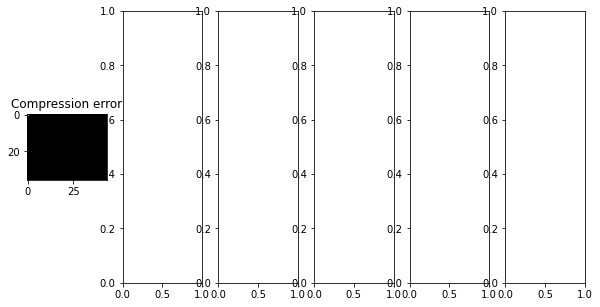

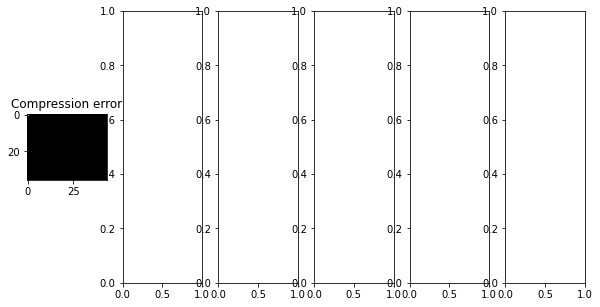

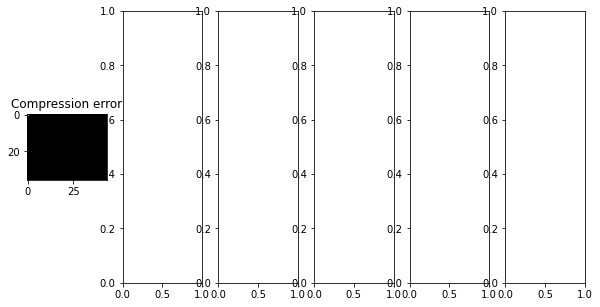

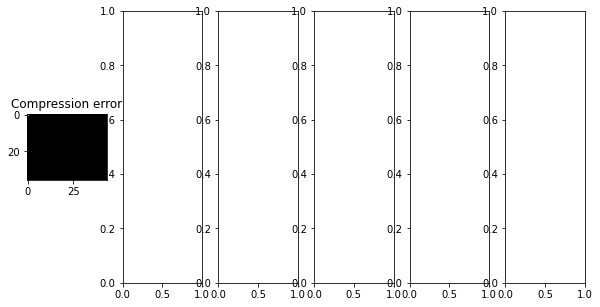

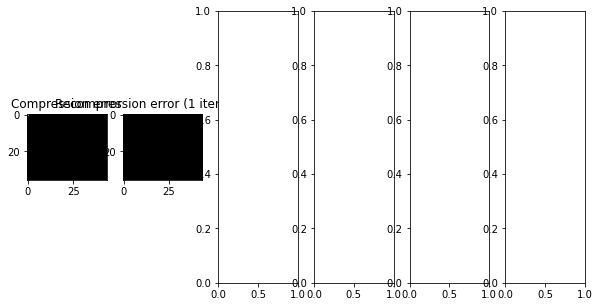

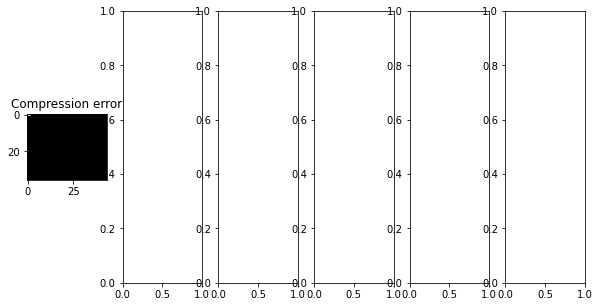

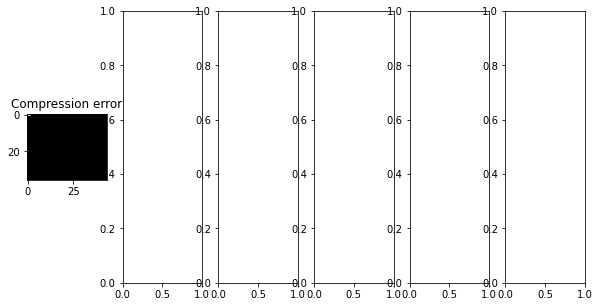

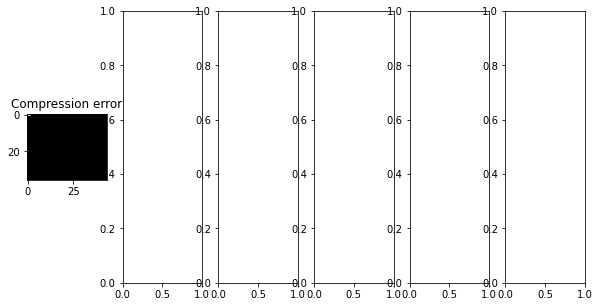

KeyboardInterrupt: 

In [20]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.fftpack import dct, idct
from skimage import io

# Load the original image, reads an image file and returns a numpy array.
img = io.imread('./input/source.jpg')

# Convert the image to grayscale
img_gray = io.imread('./input/source.jpg', as_gray=True)

# Set the block size for the DCT transform
block_size = 8

# Calculate the dimensions of the image and the number of blocks in each dimension
height, width = img_gray.shape
num_blocks_vert = height // block_size
num_blocks_horiz = width // block_size

# Set the quality factor for the JPEG compression
quality_factor = 50

# Set the number of times to recompress the image
num_recompressions = 5

# Initialize arrays to store the compression and recompression errors
compression_errors = np.zeros((num_blocks_vert, num_blocks_horiz))
recompression_errors = np.zeros((num_blocks_vert, num_blocks_horiz, num_recompressions))

# Loop through each block of the image
for i in range(num_blocks_vert):
    for j in range(num_blocks_horiz):
        # Extract the current block
        block = img_gray[i*block_size:(i+1)*block_size, j*block_size:(j+1)*block_size]

        # Apply the DCT transform to the block
        dct_block = dct(block, norm='ortho')

        # Calculate the quantization matrix based on the quality factor
        quantization_matrix = np.round((1 + (quality_factor / 50)) * np.array([
            [16, 11, 10, 16, 24, 40, 51, 61],
            [12, 12, 14, 19, 26, 58, 60, 55],
            [14, 13, 16, 24, 40, 57, 69, 56],
            [14, 17, 22, 29, 51, 87, 80, 62],
            [18, 22, 37, 56, 68, 109, 103, 77],
            [24, 35, 55, 64, 81, 104, 113, 92],
            [49, 64, 78, 87, 103, 121, 120, 101],
            [72, 92, 95, 98, 112, 100, 103, 99]
        ]))

        # Apply quantization to the DCT coefficients
        quantized_dct_block = np.round(dct_block / quantization_matrix)

        # Calculate the compression error
        compressed_block = idct(quantized_dct_block * quantization_matrix, norm='ortho')
        compression_errors[i, j] = np.mean(np.abs(block - compressed_block))

        # Recompress the block multiple times
        for k in range(num_recompressions):
            # Apply the DCT transform to the quantized block
            dct_quantized_block = dct(quantized_dct_block, norm='ortho')

            # Apply the quantization matrix to the DCT coefficients
            quantized_dct_quantized_block = np.round(dct_quantized_block / quantization_matrix)

            # Apply quantization to the DCT coefficients
            quantized_recompressed_block = idct(quantized_dct_quantized_block * quantization_matrix, norm='ortho')

            # Calculate the recompressed block
            recompressed_block = idct(quantized_recompressed_block, norm='ortho')
            recompression_errors
            #Visualize the compression and recompression errors
            fig, ax = plt.subplots(nrows=1, ncols=num_recompressions+1, figsize=(10,5))
            ax[0].imshow(compression_errors, cmap='gray')
            ax[0].set_title('Compression error')
        for k in range(num_recompressions):
            ax[k+1].imshow(recompression_errors[:,:,k], cmap='gray')
            ax[k+1].set_title(f'Recompression error ({k+1} iteration(s))')
            plt.show()